Missing values:
 location    0
year        0
category    0
rank        0
query       0
dtype: int64


C:\Users\shara\AppData\Local\Temp\ipykernel_3004\1112278785.py:22: FutureWarning:

DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\shara\AppData\Local\Temp\ipykernel_3004\1112278785.py:35: UserWarning:

Glyph 12487 (\N{KATAKANA LETTER DE}) missing from font(s) DejaVu Sans.

C:\Users\shara\AppData\Local\Temp\ipykernel_3004\1112278785.py:35: UserWarning:

Glyph 12451 (\N{KATAKANA LETTER SMALL I}) missing from font(s) DejaVu Sans.

C:\Users\shara\AppData\Local\Temp\ipykernel_3004\1112278785.py:35: UserWarning:

Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from font(s) DejaVu Sans.

C:\Users\shara\AppData\Local\Temp\ipykernel_3004\1112278785.py:35: UserWarning:

Glyph 12531 (\N{KATAKANA LETTER N}) missing from font(s) DejaVu Sans.

C:\Users\shara\AppData\Local\Temp\ipykernel_3004\1112278785.py:35: UserWarning:

Glyph 12501 (\N{KATAKANA LETTER HU}) missing from font(s) DejaVu Sans.

C:\Use

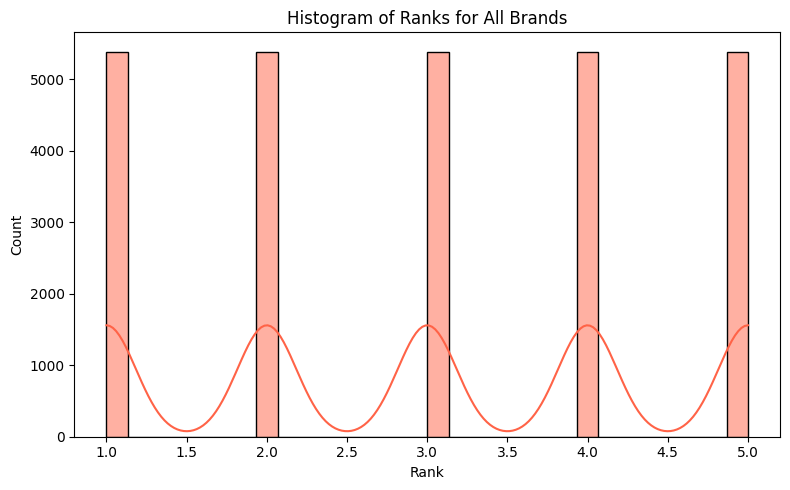

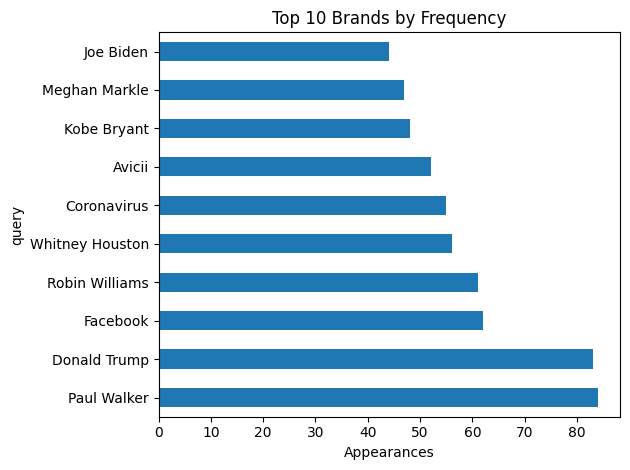

c:\Users\shara\AppData\Local\Programs\Python\Python313\Lib\site-packages\seaborn\utils.py:61: UserWarning:

Glyph 21488 (\N{CJK UNIFIED IDEOGRAPH-53F0}) missing from font(s) DejaVu Sans.

c:\Users\shara\AppData\Local\Programs\Python\Python313\Lib\site-packages\seaborn\utils.py:61: UserWarning:

Glyph 39080 (\N{CJK UNIFIED IDEOGRAPH-98A8}) missing from font(s) DejaVu Sans.

c:\Users\shara\AppData\Local\Programs\Python\Python313\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 21488 (\N{CJK UNIFIED IDEOGRAPH-53F0}) missing from font(s) DejaVu Sans.

c:\Users\shara\AppData\Local\Programs\Python\Python313\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 39080 (\N{CJK UNIFIED IDEOGRAPH-98A8}) missing from font(s) DejaVu Sans.



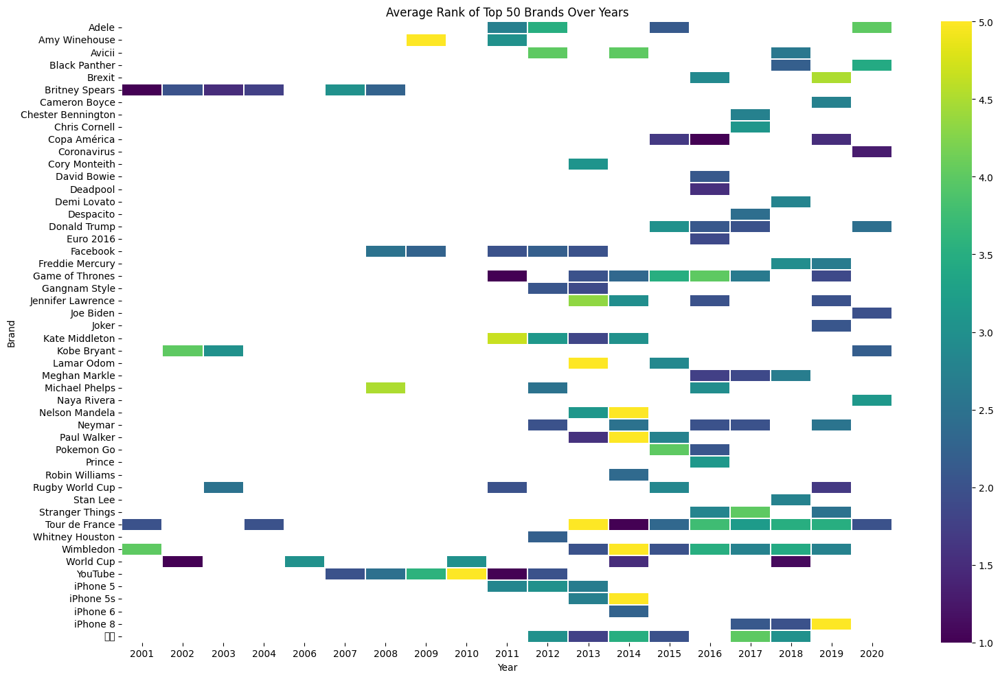

C:\Users\shara\AppData\Local\Temp\ipykernel_3004\1112278785.py:73: UserWarning:

Glyph 21488 (\N{CJK UNIFIED IDEOGRAPH-53F0}) missing from font(s) DejaVu Sans.

C:\Users\shara\AppData\Local\Temp\ipykernel_3004\1112278785.py:73: UserWarning:

Glyph 39080 (\N{CJK UNIFIED IDEOGRAPH-98A8}) missing from font(s) DejaVu Sans.

c:\Users\shara\AppData\Local\Programs\Python\Python313\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 21488 (\N{CJK UNIFIED IDEOGRAPH-53F0}) missing from font(s) DejaVu Sans.

c:\Users\shara\AppData\Local\Programs\Python\Python313\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 39080 (\N{CJK UNIFIED IDEOGRAPH-98A8}) missing from font(s) DejaVu Sans.



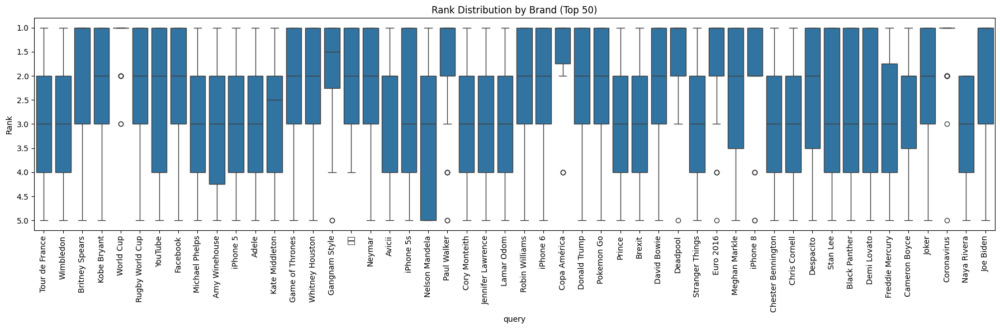

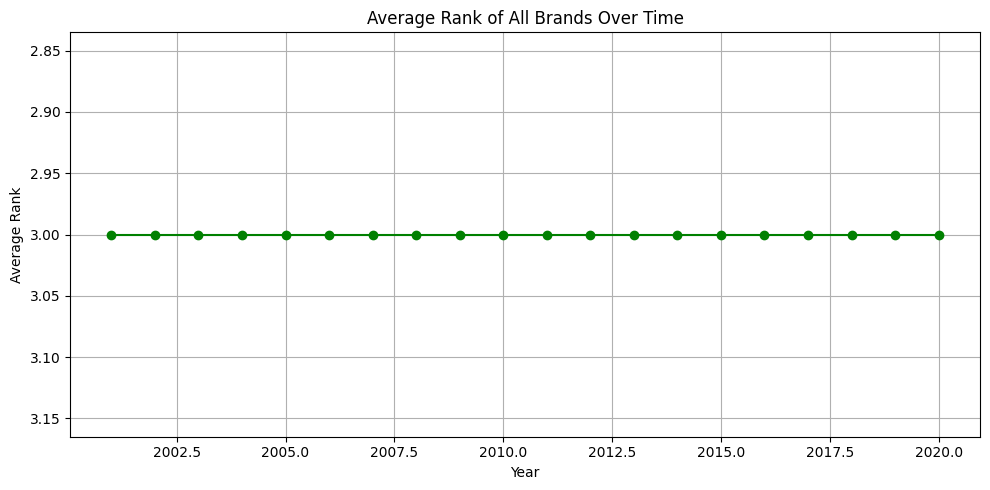

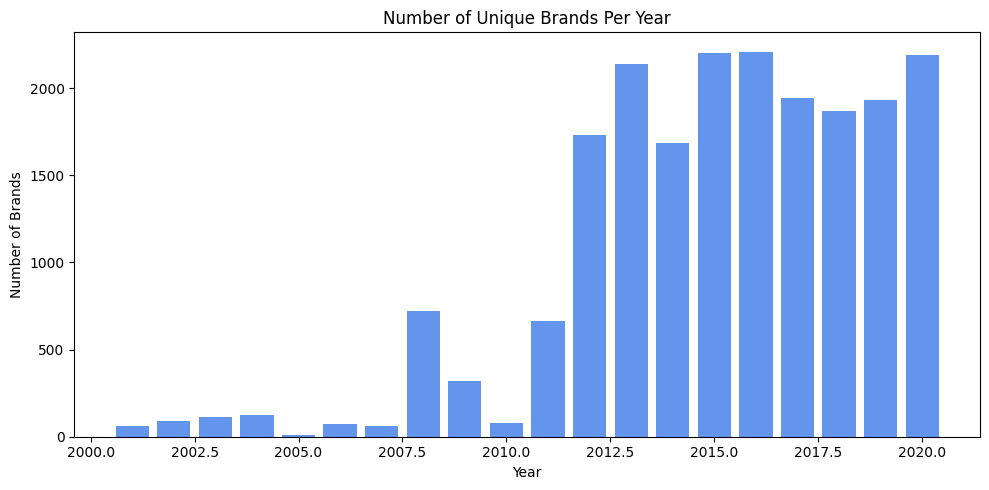

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.io as pio

# Use browser for interactive Plotly plots
pio.renderers.default = 'browser'

# Load data
df = pd.read_csv(r'C:\Users\shara\Downloads\trends.csv.zip')

# --- Preprocessing ---
print("Missing values:\n", df.isnull().sum())

df.dropna(inplace=True)
df.drop_duplicates(inplace=True)
df['year'] = df['year'].astype(int)

# --- Pivot for time series analysis ---
df_pivot = df.pivot_table(index='year', columns='query', values='rank', aggfunc='mean')
df_pivot = df_pivot.fillna(method='ffill')
df_pivot = df_pivot.dropna(axis=1, thresh=5)

# --- Line plot (All Brands) ---
plt.figure(figsize=(14, 8))
for brand in df_pivot.columns:
    plt.plot(df_pivot.index, df_pivot[brand], label=brand)
plt.gca().invert_yaxis()
plt.title('Brand Rank Over Time (All Brands)', fontsize=16)
plt.xlabel('Year')
plt.ylabel('Rank')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize='small', ncol=2)
plt.grid(True)
plt.tight_layout()
plt.show()

# --- Rank distribution histogram ---
plt.figure(figsize=(8, 5))
sns.histplot(df['rank'], bins=30, kde=True, color='tomato')
plt.title('Histogram of Ranks for All Brands')
plt.xlabel('Rank')
plt.tight_layout()
plt.show()

# --- Top 10 most frequent brands ---
top_freq = df['query'].value_counts().head(10)
top_freq.plot(kind='barh', title='Top 10 Brands by Frequency')
plt.xlabel('Appearances')
plt.tight_layout()
plt.show()

# --- Heatmap of Average Rank per Year (Top 50 brands) ---
top_50 = df['query'].value_counts().head(50).index
heatmap_data = df[df['query'].isin(top_50)]
heatmap_pivot = heatmap_data.pivot_table(index='query', columns='year', values='rank', aggfunc='mean')

plt.figure(figsize=(16, 10))
sns.heatmap(heatmap_pivot, cmap='viridis', annot=False, linewidths=0.3)
plt.title('Average Rank of Top 50 Brands Over Years')
plt.xlabel('Year')
plt.ylabel('Brand')
plt.tight_layout()
plt.show()

# --- Boxplot of Ranks by Brand (Top 50) ---
plt.figure(figsize=(18, 6))
sns.boxplot(data=heatmap_data, x='query', y='rank')
plt.title('Rank Distribution by Brand (Top 50)')
plt.ylabel('Rank')
plt.xticks(rotation=90)
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

# --- Average Rank Over Time (All Brands) ---
avg_rank_all = df.groupby('year')['rank'].mean()

plt.figure(figsize=(10, 5))
plt.plot(avg_rank_all.index, avg_rank_all.values, marker='o', color='green')
plt.title('Average Rank of All Brands Over Time')
plt.xlabel('Year')
plt.ylabel('Average Rank')
plt.gca().invert_yaxis()
plt.grid(True)
plt.tight_layout()
plt.show()

# --- Number of Brands Per Year ---
brand_counts_year = df.groupby('year')['query'].nunique()

plt.figure(figsize=(10, 5))
plt.bar(brand_counts_year.index, brand_counts_year.values, color='cornflowerblue')
plt.title('Number of Unique Brands Per Year')
plt.xlabel('Year')
plt.ylabel('Number of Brands')
plt.tight_layout()
plt.show()

# --- Interactive Plotly Line Plot (All Brands from Pivot) ---
df_plotly = df[df['query'].isin(df_pivot.columns)]
fig = px.line(df_plotly, x='year', y='rank', color='query', title='Interactive Brand Rank Over Time (All Brands)')
fig.update_yaxes(autorange='reversed')
fig.update_layout(height=600)
fig.show()
